In [3]:
import pandas as pd
import numpy as np
import pickle
from src.constants import *
from src.neuron import *
from src.utils import *
from src.network import *
from src.validation import *
from src.viz import *
from src.genetic_algorithm import *
from multiprocessing import Pool
from functools import partial
import ast

In [4]:
# Load in unclean data
pkl_file = '/Users/stevenwendel/Documents/GitHub/bg/combined_data.pkl'

with open(pkl_file, 'rb') as f: 
    ga_results = pickle.load(f)


In [15]:
# Cut away any data that's less than threshold (728) and reduces all weights between -2 and 2
min_score = 729
minimum_weight = 5
ga_results1 = []

for i in range(len(ga_results)):
    dna = ga_results[i]['dna'].copy()
    dna_score = ga_results[i]['dna_score']

    if dna_score >= min_score:
        for j in range(len(dna)):
            if abs(dna[j]) >= minimum_weight:
                ...
            else:
                dna[j] = 0 
        mod_dict = {
            'dna': tuple(dna), 
            'dna_score': dna_score, 
            'is_child': False}
        ga_results1.append(mod_dict)

In [16]:
# Remove duplicates from list of trial dictionaries
ga_results2 = []
seen_configs = set()
for idx in range(len(ga_results1)):
    dna = tuple(ga_results1[idx]['dna'])
    if dna in seen_configs:
        print(f"Found a copy at {idx=}")
        continue
    else:
        seen_configs.add(dna)
        ga_results2.append(ga_results1[idx])

Found a copy at idx=1
Found a copy at idx=4
Found a copy at idx=5
Found a copy at idx=6
Found a copy at idx=7
Found a copy at idx=8
Found a copy at idx=9
Found a copy at idx=11
Found a copy at idx=12
Found a copy at idx=13
Found a copy at idx=16
Found a copy at idx=20
Found a copy at idx=21
Found a copy at idx=22
Found a copy at idx=23
Found a copy at idx=24
Found a copy at idx=25
Found a copy at idx=26
Found a copy at idx=27
Found a copy at idx=28
Found a copy at idx=30
Found a copy at idx=31
Found a copy at idx=32
Found a copy at idx=33
Found a copy at idx=35
Found a copy at idx=38
Found a copy at idx=39
Found a copy at idx=40
Found a copy at idx=41
Found a copy at idx=42
Found a copy at idx=43
Found a copy at idx=44
Found a copy at idx=45
Found a copy at idx=46
Found a copy at idx=49
Found a copy at idx=50
Found a copy at idx=51
Found a copy at idx=54
Found a copy at idx=55
Found a copy at idx=56
Found a copy at idx=57
Found a copy at idx=58
Found a copy at idx=61
Found a copy at id

In [17]:
# checking to make sure types are right
for idx in range(len(ga_results2)):
    if type(ga_results2[idx]['dna']) != tuple:
        print(type(ga_results2[idx]['dna']))
    # if type(ga_results[idx]['dna']) == list:
    #     print(idx)
    #     break

In [18]:
# check size difference after removing duplicates
print(len(ga_results2))
print(len(ga_results1))

125419
130048


In [19]:
#Sort results
sorted_results = sorted(ga_results2, key=lambda x: x['dna_score'], reverse=True)
sorted_results[-1]

{'dna': (330,
  0,
  0,
  713,
  -127,
  0,
  0,
  0,
  -164,
  0,
  0,
  0,
  -55,
  -5,
  0,
  0,
  -269,
  0,
  -71,
  90,
  0,
  0,
  0,
  0,
  143,
  567,
  0,
  0,
  0,
  0,
  0,
  279,
  72,
  163,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -95,
  0,
  0,
  0,
  43,
  60,
  26),
 'dna_score': 729,
 'is_child': False}

In [20]:
max_synapses = 25
unique_dna_sequences = set()
unique_trials = []

for i in range(len(sorted_results)):
    trial_dna = sorted_results[i]['dna']
    config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
    synapses = sum(config_mask)
    if synapses <= max_synapses:
        if config_mask in unique_dna_sequences:
            print(f'seen this before...{config_mask}')
            continue
        else:
            print(f'A new mask! {config_mask}')
            unique_dna_sequences.add(config_mask)
            unique_trials.append(sorted_results[i])

A new mask! (1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 

In [25]:
print(len(unique_dna_sequences))
print(len(unique_trials))

1
1


In [22]:
#saving the cleaned data
with open(f'combined_data_clean_{min_score}_pass_0.pkl', 'wb') as f:
    pickle.dump(unique_trials, f)

In [23]:
#loading the cleaned data
with open(f'/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_{min_score}_pass_0.pkl', 'rb') as f:
    clean_unique_runs = pickle.load(f)    

In [26]:
clean_unique_runs

[{'dna': (602,
   0,
   0,
   1000,
   -26,
   -7,
   0,
   0,
   -35,
   0,
   0,
   0,
   -80,
   0,
   0,
   0,
   -1000,
   0,
   0,
   58,
   0,
   0,
   0,
   0,
   1000,
   233,
   0,
   0,
   0,
   0,
   0,
   43,
   84,
   569,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   -1000,
   -130,
   0,
   0,
   42,
   499,
   246),
  'dna_score': 741,
  'is_child': False},
 {'dna': (1000,
   0,
   0,
   888,
   -32,
   -8,
   0,
   0,
   -27,
   0,
   0,
   0,
   -36,
   0,
   0,
   0,
   -708,
   0,
   0,
   46,
   0,
   0,
   0,
   0,
   950,
   397,
   0,
   0,
   0,
   0,
   0,
   411,
   101,
   525,
   0,
   0,
   0,
   0,
   -16,
   0,
   0,
   0,
   -180,
   -105,
   0,
   0,
   42,
   632,
   229),
  'dna_score': 741,
  'is_child': False},
 {'dna': (1000,
   0,
   0,
   1000,
   -7,
   0,
   0,
   0,
   -17,
   0,
   0,
   0,
   -26,
   0,
   0,
   0,
   -1000,
   0,
   -15,
   63,
   0,
   0,
   0,
   0,
   445,
   180,
   -173,
   0,
   0,
   0,
   0,
   28,
   169,
  

In [24]:

from src.workers import process_parent_dna
from multiprocessing import Manager, Process, Pool
import time
parents = clean_unique_runs
fully_reduced_dnas = []
min_score

iteration=0
start_time= time.time()

while len(parents)>0:
    current_time = time.time()
    print(f'Beginning iteration #{iteration}')
    print(f'Current # of fully_reduced_dnas: {len(fully_reduced_dnas)}')
    print(f'Current # of young parents: {len(parents)}')

    #sorting by highest value
    sorted_results = sorted(parents, key=lambda x: x['dna_score'], reverse=True)

    # sifting for unique configurations
    unique_dna_sequences = set()
    unique_trials = []

    for i in range(len(sorted_results)):
        trial_dna = sorted_results[i]['dna']
        config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
        
        if config_mask in unique_dna_sequences:
            print(f'seen this before...{config_mask}')
            continue
        else:
            print(f'A new mask! {config_mask}')
            unique_dna_sequences.add(config_mask)
            unique_trials.append(sorted_results[i])
    print(f'# Unique dnas from parent collection: {len(unique_trials)}')

    parents=unique_trials



    with Pool(processes=6) as pool:
        ffunct =  partial(process_parent_dna, min_score=min_score)
        results = pool.map(ffunct, parents)
    # print(results)

    children = []
    for processor in results:
        print("inspecting processor...")
        for survivor in processor:
            print('inspecting survivor...')
            if survivor['is_child']:
                children.append(survivor)
            elif not survivor['is_child']:
                fully_reduced_dnas.append(survivor)

    print(f'# Children produced in pass: {len(children)}')
    print(f'Pass took: {time.time()-current_time} seconds')
    iteration +=1
    
    #saving the cleaned data
    with open(f'combined_data_clean_{min_score}_pass_{iteration}.pkl', 'wb') as f:
        pickle.dump({'fully_reduced_dnas': fully_reduced_dnas, 'children': children}, f)

    parents = children

print(f'All runs took {time.time()-start_time} seconds')

Beginning iteration #0
Current # of fully_reduced_dnas: 0
Current # of young parents: 1348
A new mask! (1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 

In [18]:
len(children)

11119

In [27]:
with open(f'/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_{min_score}_pass_10.pkl', 'rb') as f:
    pass_results = pickle.load(f)

In [28]:
print(len(pass_results['fully_reduced_dnas']))
print(len(pass_results['children']))

494
0


This is for checking stuff later


In [29]:
fully_reduced_dnas

[{'dna': (295,
   0,
   0,
   909,
   -26,
   -290,
   0,
   0,
   0,
   0,
   0,
   0,
   -25,
   0,
   0,
   0,
   -891,
   0,
   0,
   63,
   0,
   0,
   0,
   0,
   723,
   646,
   0,
   0,
   0,
   0,
   0,
   31,
   131,
   283,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   -568,
   -437,
   0,
   0,
   29,
   1000,
   1000),
  'dna_score': 739,
  'is_child': False},
 {'dna': (1000,
   0,
   0,
   830,
   -84,
   0,
   0,
   0,
   -23,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   -188,
   0,
   0,
   65,
   0,
   0,
   0,
   0,
   901,
   1000,
   0,
   0,
   0,
   0,
   0,
   1000,
   68,
   157,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   -1000,
   0,
   0,
   0,
   42,
   237,
   30),
  'dna_score': 739,
  'is_child': False},
 {'dna': (395,
   0,
   0,
   952,
   -59,
   0,
   0,
   0,
   -64,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   -1000,
   0,
   0,
   131,
   0,
   0,
   0,
   0,
   455,
   106,
   -17,
   0,
   0,
   0,
   0,
   102,
   78,
   960,
   0,
 

In [31]:
 #CHECK RESULTS
curr_dna = fully_reduced_dnas[1]['dna']
# Load DNA
dna_matrix = load_dna(curr_dna)


# === Preparing Network === 
all_neurons = create_neurons()
splits, input_waves, alpha_array = create_experiment()
criteria_dict = define_criteria()
max_score = TMAX//BIN_SIZE * len(CRITERIA_NAMES)

dna_score, neuron_data = evaluate_dna(
                dna_matrix=dna_matrix,
                neurons=all_neurons,
                alpha_array=alpha_array,
                input_waves=input_waves,
                criteria=criteria_dict,
                curr_dna=curr_dna
                )
total_score = sum(dna_score.values())
print(f'    === DNA: {curr_dna}') 
print(f'    === Control: {dna_score["control"]}/{max_score}')
print(f'    === Experimental: {dna_score["experimental"]}/{max_score}')
print(f'    === Overall: {total_score}({total_score/(2*max_score):.2%})')
print('\n')


diagnostic = {
        'show_dna_matrix' : True,
        'show_neuron_plots' : True,
        'show_difference_histogram' : False,
        'show_dna_scores': False
    }

if diagnostic['show_dna_matrix']:
                print("Currently loaded matrix ---")
                display_matrix(dna_matrix, NEURON_NAMES)

if diagnostic['show_dna_scores']:
                print(f'{dna_score=}: {curr_dna}')
            
if diagnostic['show_neuron_plots']:
                for condition in ['experimental', 'control']:
                    target_neurons_hist_Vs = np.array([neuron_data[condition][name]['hist_V'] for name in NEURON_NAMES])
                    plot_neurons_interactive(hist_Vs=target_neurons_hist_Vs, neuron_names=NEURON_NAMES, sq_wave=input_waves[0], go_wave=input_waves[1], show_u=False)
                    

    === DNA: (1000, 0, 0, 830, -84, 0, 0, 0, -23, 0, 0, 0, 0, 0, 0, 0, -188, 0, 0, 65, 0, 0, 0, 0, 901, 1000, 0, 0, 0, 0, 0, 1000, 68, 157, 0, 0, 0, 0, 0, 0, 0, 0, -1000, 0, 0, 0, 42, 237, 30)
    === Control: 249/500
    === Experimental: 470/500
    === Overall: 719(71.90%)


Currently loaded matrix ---


,Somat,MSN1,SNR1,VMprep,ALMprep,MSN2,SNR2,PPN,THALgo,ALMinter,MSN3,SNR3,ALMresp,VMresp
Somat,0.0,830.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
MSN1,0.0,0.0,-84.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SNR1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
VMprep,0.0,0.0,0.0,0.0,65.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ALMprep,0.0,0.0,0.0,68.0,0.0,1000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
MSN2,0.0,0.0,0.0,0.0,0.0,0.0,-23.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SNR2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-188.0
PPN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,42.0,0.0,0.0,0.0,0.0,0.0
THALgo,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,237.0,0.0,0.0,30.0,0.0
ALMinter,0.0,0.0,0.0,0.0,-1000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


And below here we have the graph...

In [38]:
# Calculate proportion of graphs with vector
# Calculate the number of DNAs
num_dnas = len(fully_reduced_dnas)

# Determine which connections are shared by more than 50% of the DNAs
shared_connections = np.zeros(len(ACTIVE_SYNAPSES), dtype=int)

for item in fully_reduced_dnas:
    shared_connections += np.array([1 if weight != 0 else 0 for weight in item['dna']])
    
connection_percentages = np.round(shared_connections/num_dnas*100,0)

cpl = [int(i) if i>=50 else 0 for i in connection_percentages]
print(cpl)

[100, 0, 0, 95, 85, 58, 0, 0, 65, 0, 0, 0, 57, 0, 0, 0, 98, 0, 0, 100, 0, 0, 0, 0, 100, 95, 0, 0, 0, 0, 0, 90, 100, 100, 0, 0, 0, 0, 0, 0, 0, 0, 94, 0, 0, 0, 100, 98, 100]


In [43]:
# Create a labeled Series for the DNA for reference - don't need for graph
cplSeries = pd.Series(cpl, index=[f"{pair[0]} -> {pair[1]}" for pair in ACTIVE_SYNAPSES])
print(cplSeries)


Somat -> ALMprep       100
Somat -> ALMinter        0
Somat -> ALMresp         0
Somat -> MSN1           95
MSN1 -> SNR1            85
MSN1 -> SNR2            58
MSN1 -> SNR3             0
MSN2 -> SNR1             0
MSN2 -> SNR2            65
MSN2 -> SNR3             0
MSN3 -> SNR1             0
MSN3 -> SNR2             0
MSN3 -> SNR3            57
SNR1 -> VMprep           0
SNR1 -> VMresp           0
SNR2 -> VMprep           0
SNR2 -> VMresp          98
SNR3 -> VMprep           0
SNR3 -> VMresp           0
VMprep -> ALMprep      100
VMprep -> ALMinter       0
VMprep -> ALMresp        0
VMresp -> ALMprep        0
VMresp -> ALMinter       0
VMresp -> ALMresp      100
ALMprep -> MSN2         95
ALMinter -> MSN1         0
ALMinter -> MSN2         0
ALMinter -> MSN3         0
ALMresp -> MSN1          0
ALMresp -> MSN2          0
ALMresp -> MSN3         90
ALMprep -> VMprep      100
ALMresp -> VMresp      100
MSN1 -> MSN2             0
MSN1 -> MSN3             0
MSN2 -> MSN1             0
M

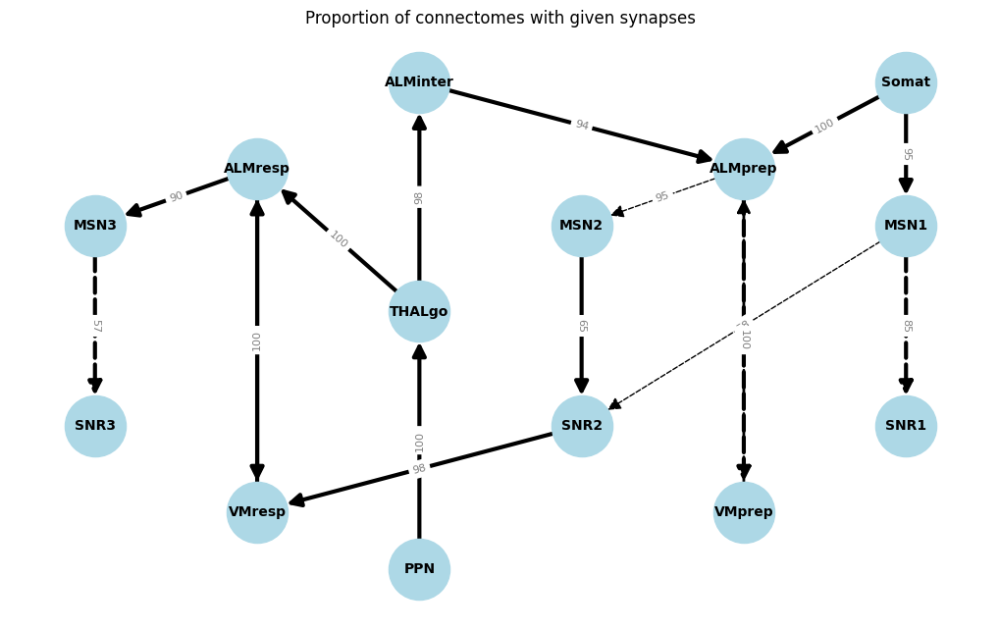

In [49]:
import networkx as nx
import matplotlib.pyplot as plt

# Define custom positions for each node
neu_coords = {
    'Somat': (5, 8.5),
    'MSN1': (5, 6),
    'MSN2': (3, 6),
    'MSN3': (0, 6),
    'SNR1': (5, 2.5),
    'SNR2': (3, 2.5),
    'SNR3': (0, 2.5),
    'ALMinter': (2, 8.5),
    'PPN': (2, 0),
    'THALgo': (2, 4.5),
    'VMprep': (4, 1),
    'ALMprep': (4, 7),
    'ALMresp': (1, 7),
    'VMresp': (1, 1)
}

# Create a graph
G = nx.DiGraph()

# Add nodes for each neuron
G.add_nodes_from(NEURON_NAMES)

# Add edges, styles, and widths for non-zero synaptic connections
edge_widths =[]
edge_styles = []
for i in range(len(cpl)):
    val= cpl[i]
    if val != 0:
        G.add_edge(ACTIVE_SYNAPSES[i][0], ACTIVE_SYNAPSES[i][1], weight=val)
        edge_widths.append(np.ceil(abs(val) / 20) - 2)
        if ACTIVE_SYNAPSES[i][0] in INHIBITORY_NEURONS:
            edge_styles.append('dashed')
        else:
            edge_styles.append('solid')


# Draw the main graph using the custom positions
plt.figure(figsize=(10, 6))
edges = G.edges(data=True)
nx.draw(G, pos=neu_coords, with_labels=True, node_size=2000, node_color='lightblue', font_size=10, font_weight='bold', arrowsize=20,
        width=edge_widths,
        style=edge_styles,
        edge_color='black')


# Add edge labels
edge_labels = nx.get_edge_attributes(G, 'weight')
nx.draw_networkx_edge_labels(G, pos=neu_coords, edge_labels=edge_labels, font_color='gray',font_size=8)

plt.title('Proportion of connectomes with given synapses')
plt.show()